In [1]:
import umap
import numpy as np
import pandas as pd
import plotly.express as px

from sklearn.decomposition import PCA
import preparation.database as database

import utils.constants as constants
import utils.validating as validating
from utils.text_processing import load_embeddings, text2vec, text2vec_adjusted

<AxesSubplot:xlabel='SUBJECT'>

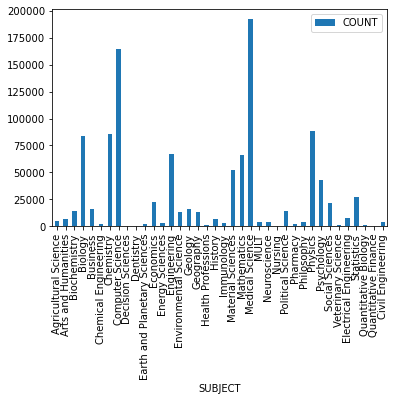

In [3]:
counts_df = pd.read_csv(constants.SUBJECT_INFO)
counts_df.plot(kind = "bar", x='SUBJECT', y='COUNT')

In [4]:
subject_embeddings, dim = load_embeddings(constants.SUBJECT_EMBEDDINGS)
embeddings, dim = load_embeddings(constants.STARSPACE_EMBEDDINGS)

In [ ]:
reducer = umap.UMAP(n_components=2, verbose=True, transform_seed=1234)
# reducer = PCA(n_components=2)

initial_subject_embeddings = np.array(list(subject_embeddings.values()))
mapped_subject_embeddings = reducer.fit_transform(initial_subject_embeddings)

mapped_df = pd.DataFrame(mapped_subject_embeddings, columns = ["X", "Y"])
subjects_df = pd.DataFrame(subject_embeddings.keys(), columns = ["SUBJECT"])
counts_df = pd.read_csv(constants.SUBJECT_INFO)

subjects_data = pd.concat([subjects_df, mapped_df], axis = 1)
subjects_data = subjects_data.merge(counts_df, on = "SUBJECT")

In [8]:
fig = px.scatter(
    subjects_data, 
    title="Subject Embeddings Mapped to 2D", 
    x="X", 
    y="Y", 
    text="SUBJECT", 
    height=800, 
    size = "COUNT", 
    color="SUBJECT", 
    color_discrete_map=constants.SUBJECTS2COLOR
)
fig.show()

<AxesSubplot:>

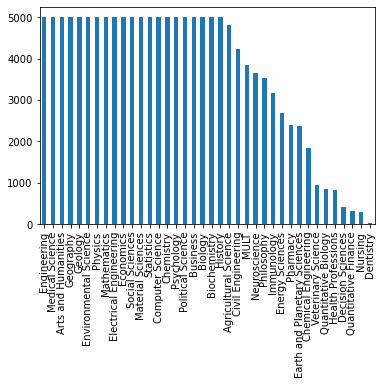

In [9]:
data = database.extract_stratified_sample(n_per_subject=5_000)
# data = data.sample(n=200_000)
data["SUBJECT"].value_counts().plot(kind = "bar")

# Embeddings

In [ ]:
reducer = umap.UMAP(n_components=2, verbose=True, random_state=1234)
# reducer = PCA(n_components=2)

data2D = data.copy()
initial_embeddings = np.stack(data2D["ABSTRACT"].apply(lambda text: text2vec(text, embeddings, dim)))

print("Finished embeddings")

mapped_embeddings = reducer.fit_transform(initial_embeddings)
mapped_subject_embeddings = reducer.transform(initial_subject_embeddings)

data2D["X"] = mapped_embeddings[:, 0]
data2D["Y"] = mapped_embeddings[:, 1]

data2D["COLOR"] = data2D["SUBJECT"].apply(lambda subject: constants.SUBJECTS2COLOR[subject])
data2D["HOVER"] = data2D["TITLE"] + "<br>" + data2D["SUBJECT"]

In [9]:
data2DSubjects = pd.DataFrame()
data2DSubjects["X"] = mapped_subject_embeddings[:, 0]
data2DSubjects["Y"] = mapped_subject_embeddings[:, 1]
data2DSubjects["TITLE"] = subject_embeddings.keys()
data2DSubjects["SUBJECT"] = subject_embeddings.keys()
data2DSubjects["COLOR"] = data2DSubjects["SUBJECT"].apply(lambda subject: constants.SUBJECTS2COLOR[subject])

In [10]:
validating.visualize(data2D, data2DSubjects)

# Subject Adjusted Embeddings

In [ ]:
reducer = umap.UMAP(n_components=2, verbose=True, random_state=1234)
# reducer = PCA(n_components=2)

data2DAdjusted = data.copy()

initial_embeddings = data2DAdjusted.apply(lambda row: text2vec_adjusted(row["ABSTRACT"], embeddings, dim, row["SUBJECT"], subject_embeddings), axis = 1)
initial_embeddings = np.stack(initial_embeddings)

print("Finished")

mapped_embeddings = reducer.fit_transform(initial_embeddings)
mapped_subject_embeddings = reducer.transform(initial_subject_embeddings)

data2DAdjusted["X"] = mapped_embeddings[:, 0]
data2DAdjusted["Y"] = mapped_embeddings[:, 1]
data2DAdjusted["COLOR"] = data2DAdjusted["SUBJECT"].apply(lambda subject: constants.SUBJECTS2COLOR[subject])
data2DAdjusted["HOVER"] = data2DAdjusted["TITLE"] + "<br>" + data2D["SUBJECT"]

In [12]:
data2DSubjects = pd.DataFrame()
data2DSubjects["X"] = mapped_subject_embeddings[:, 0]
data2DSubjects["Y"] = mapped_subject_embeddings[:, 1]
data2DSubjects["TITLE"] = subject_embeddings.keys()
data2DSubjects["SUBJECT"] = subject_embeddings.keys()
data2DSubjects["COLOR"] = data2DSubjects["SUBJECT"].apply(lambda subject: constants.SUBJECTS2COLOR[subject])

In [13]:
validating.visualize(data2DAdjusted, data2DSubjects)